### 1. Se pide:

A partir del archivo "USA_Housing.csv", realizar la regresión no lineal entre cada columna numérica con la columna 'price' utilizando:

- Regresión polinómica no lineal con grados del 2 al 10. ¿El score se estanca a partir de cierto grado?
- SVR

In [2]:
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import PolynomialFeatures
from sklearn.linear_model import LinearRegression
import matplotlib.pyplot as plt
from sklearn.metrics import r2_score, mean_absolute_error
import numpy as np
from sklearn import svm
from visualize_boundary import visualize_boundary
import seaborn as sns

In [3]:
import pandas as pd

df = pd.read_csv("../data/USA_Housing.csv")
df

,Avg. Area Income,Avg. Area House Age,Avg. Area Number of Rooms,Avg. Area Number of Bedrooms,Area Population,Price,Address
0,79545.458574,5.682861,7.009188,4.09,23086.800503,1.059034e+06,"208 Michael Ferry Apt. 674\nLaurabury, NE 3701..."
1,79248.642455,6.002900,6.730821,3.09,40173.072174,1.505891e+06,"188 Johnson Views Suite 079\nLake Kathleen, CA..."
2,61287.067179,5.865890,8.512727,5.13,36882.159400,1.058988e+06,"9127 Elizabeth Stravenue\nDanieltown, WI 06482..."
3,63345.240046,7.188236,5.586729,3.26,34310.242831,1.260617e+06,USS Barnett\nFPO AP 44820
4,59982.197226,5.040555,7.839388,4.23,26354.109472,6.309435e+05,USNS Raymond\nFPO AE 09386
...,...,...,...,...,...,...,...
4995,60567.944140,7.830362,6.137356,3.46,22837.361035,1.060194e+06,USNS Williams\nFPO AP 30153-7653
4996,78491.275435,6.999135,6.576763,4.02,25616.115489,1.482618e+06,"PSC 9258, Box 8489\nAPO AA 42991-3352"
4997,63390.686886,7.250591,4.805081,2.13,33266.145490,1.030730e+06,"4215 Tracy Garden Suite 076\nJoshualand, VA 01..."
4998,68001.331235,5.534388,7.130144,5.44,42625.620156,1.198657e+06,USS Wallace\nFPO AE 73316


In [3]:
df.columns

Index(['Avg. Area Income', 'Avg. Area House Age', 'Avg. Area Number of Rooms',
       'Avg. Area Number of Bedrooms', 'Area Population', 'Price', 'Address'],
      dtype='object')

(4000, 3)
Score: 40.73680596003446


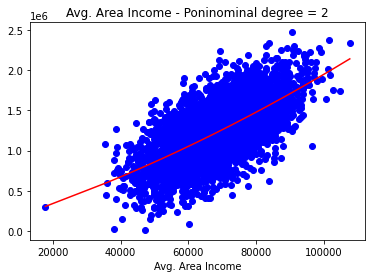

(4000, 4)
Score: 40.73967472264401


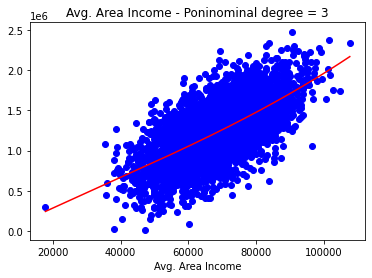

(4000, 5)
Score: 40.745310056226025


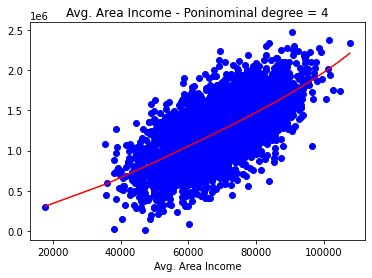

(4000, 6)
Score: 40.74277884213527


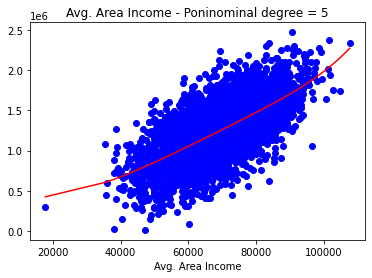

(4000, 7)
Score: 40.7107818394821


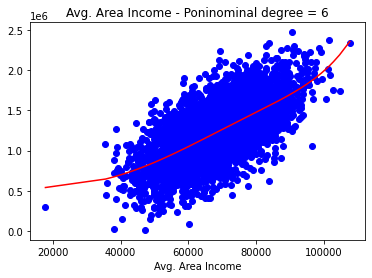

(4000, 8)
Score: 40.618775544462906


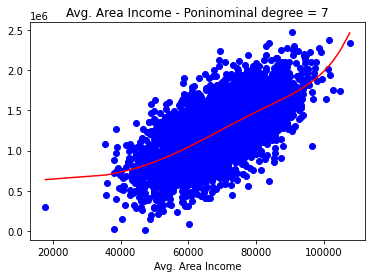

(4000, 9)
Score: 40.43097951215202


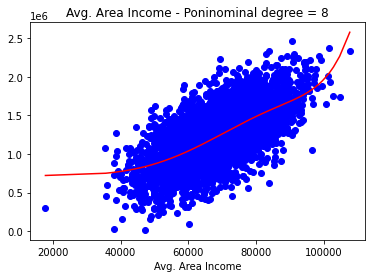

(4000, 10)
Score: 40.114947836991355


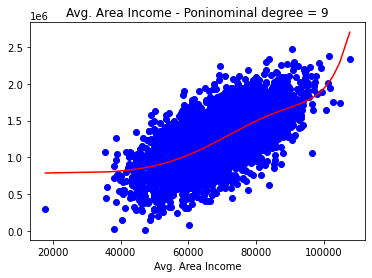

(4000, 11)
Score: 39.64781524350628


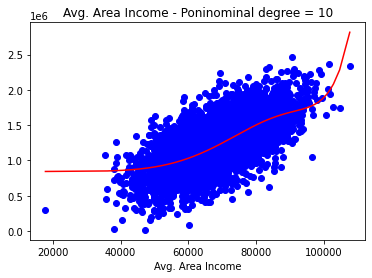

(4000, 3)
Score: 20.74482605668877


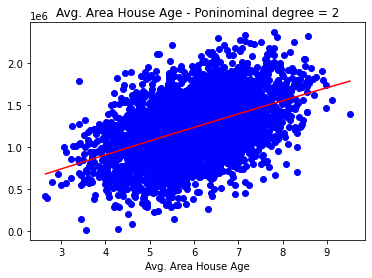

(4000, 4)
Score: 20.764500937614404


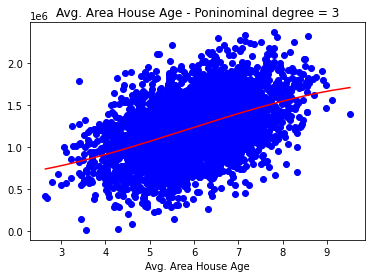

(4000, 5)
Score: 20.764668567705534


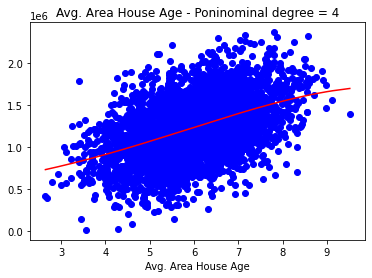

(4000, 6)
Score: 20.81611763243335


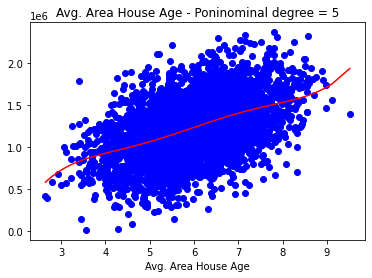

(4000, 7)
Score: 20.934741920484612


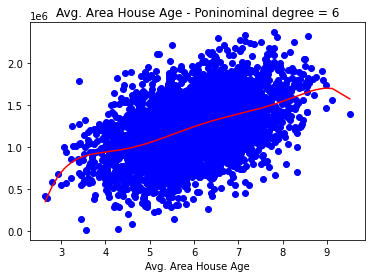

(4000, 8)
Score: 21.0120596318059


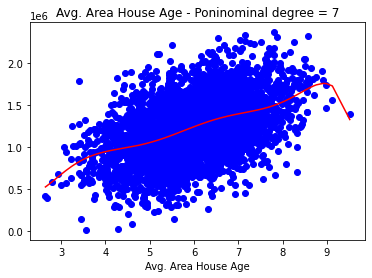

(4000, 9)
Score: 21.015629872404595


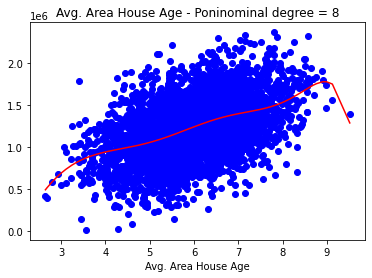

(4000, 10)
Score: 21.108869380578486


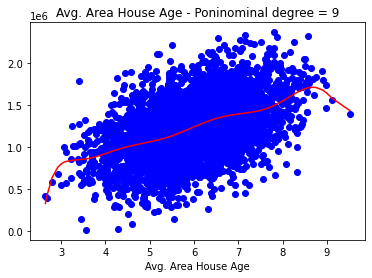

(4000, 11)
Score: 21.12195394668972


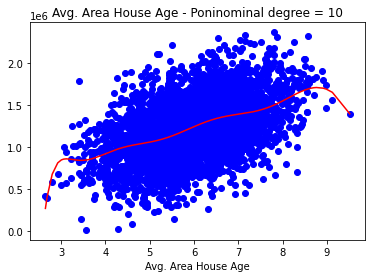

(4000, 3)
Score: 11.98966462003086


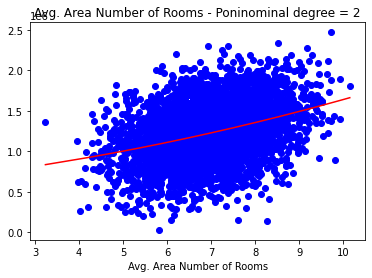

(4000, 4)
Score: 11.999482208160329


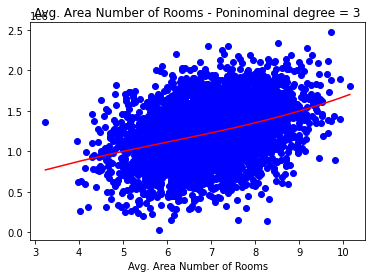

(4000, 5)
Score: 12.043568771637714


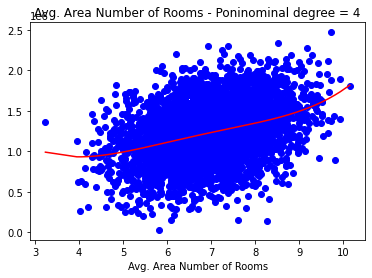

(4000, 6)
Score: 12.0664794652249


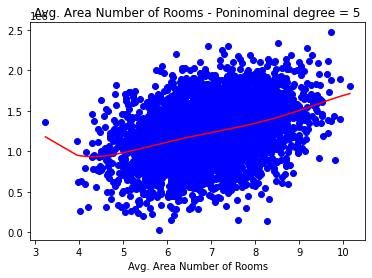

(4000, 7)
Score: 12.068458488094425


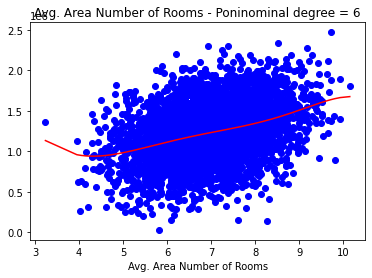

(4000, 8)
Score: 12.077217035288445


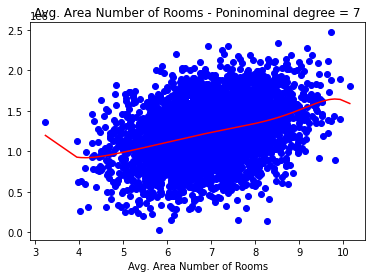

(4000, 9)
Score: 12.159323339272943


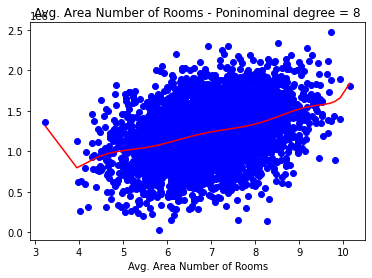

(4000, 10)
Score: 12.212534016499333


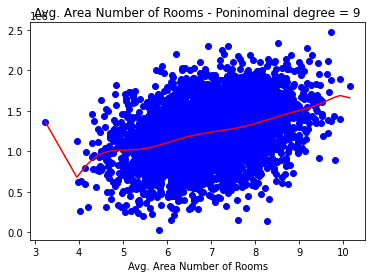

(4000, 11)
Score: 12.216630571734822


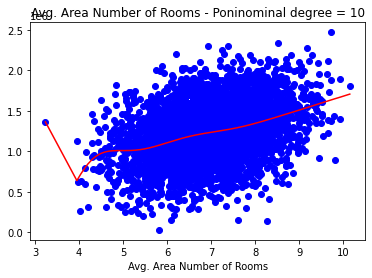

(4000, 3)
Score: 2.684513460381388


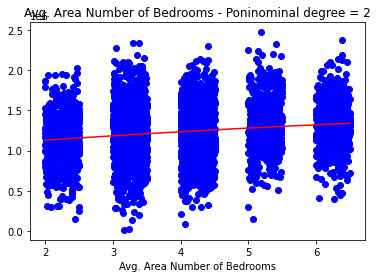

(4000, 4)
Score: 2.689978303004892


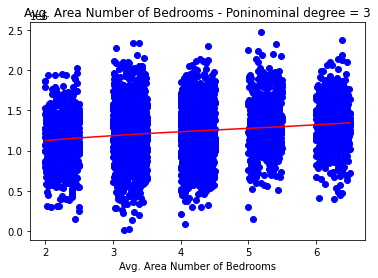

(4000, 5)
Score: 3.135202198547571


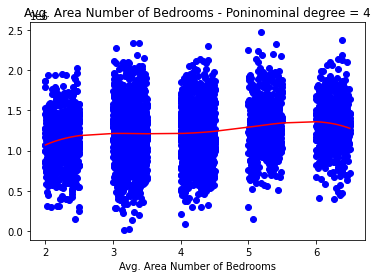

(4000, 6)
Score: 3.180251611504914


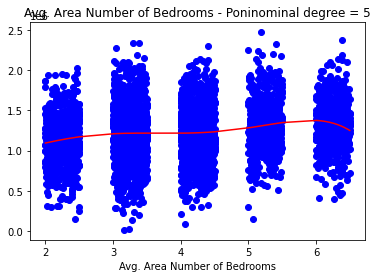

(4000, 7)
Score: 3.387997107386298


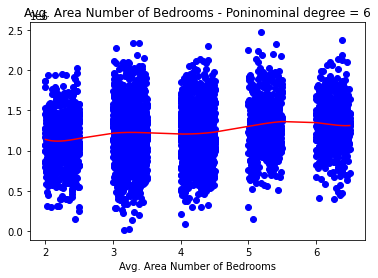

(4000, 8)
Score: 3.388068719443038


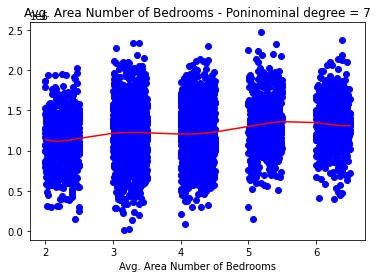

(4000, 9)
Score: 3.3992165532157337


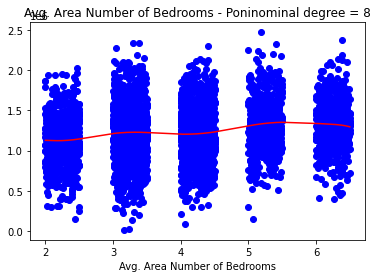

(4000, 10)
Score: 3.41447956804678


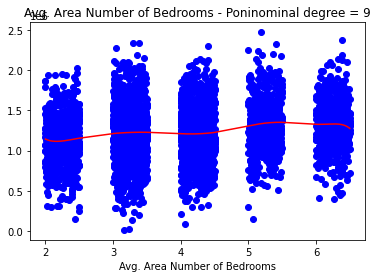

(4000, 11)
Score: 3.442808242132722


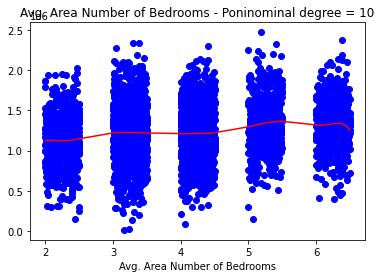

(4000, 3)
Score: 17.148493569365396


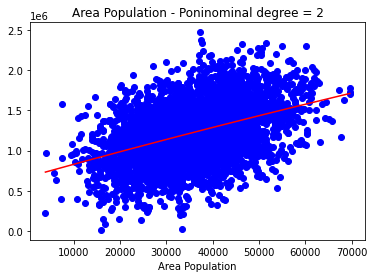

(4000, 4)
Score: 17.152114612255097


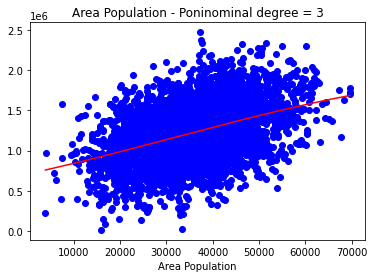

(4000, 5)
Score: 17.141952969807285


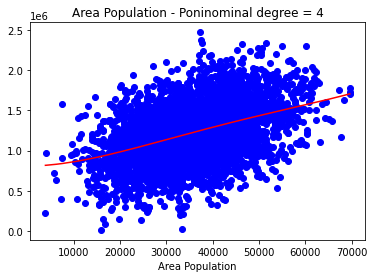

(4000, 6)
Score: 17.081621855388352


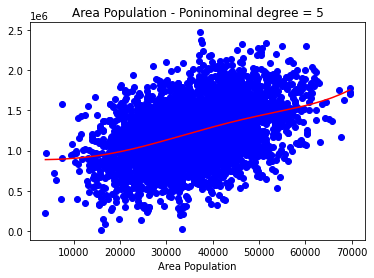

(4000, 7)
Score: 16.91566026496024


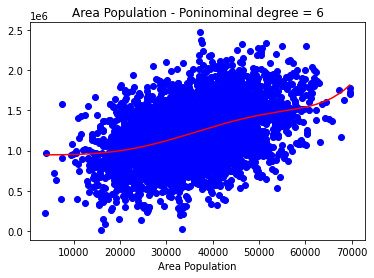

(4000, 8)
Score: 16.60384095702834


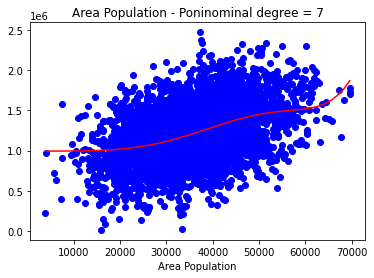

(4000, 9)
Score: 16.134088477709852


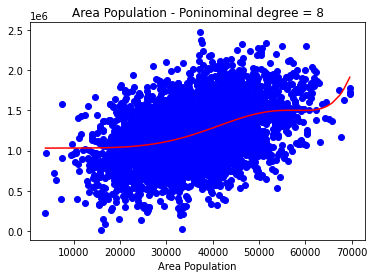

(4000, 10)
Score: 15.520421284032704


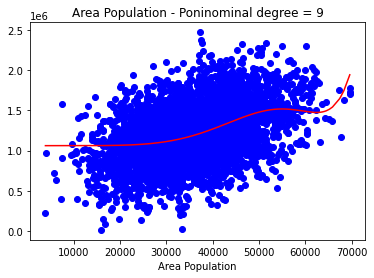

(4000, 11)
Score: 14.7921411362136


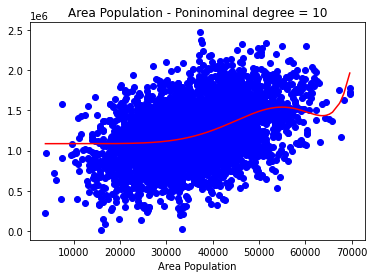

(4000, 3)
Score: 17.148493569365396


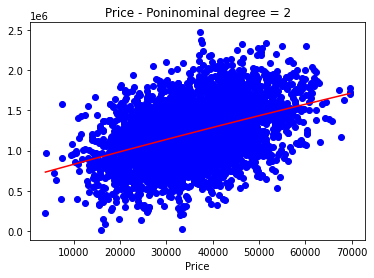

(4000, 4)
Score: 17.152114612255097


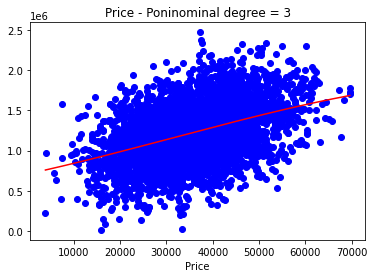

(4000, 5)
Score: 17.141952969807285


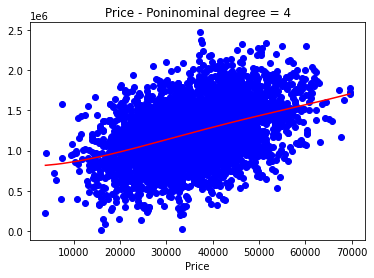

(4000, 6)
Score: 17.081621855388352


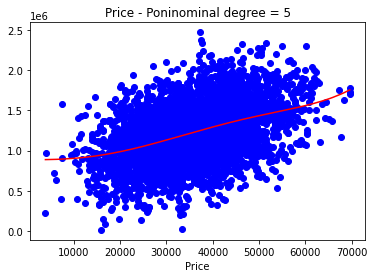

(4000, 7)
Score: 16.91566026496024


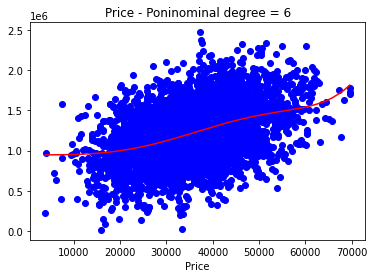

(4000, 8)
Score: 16.60384095702834


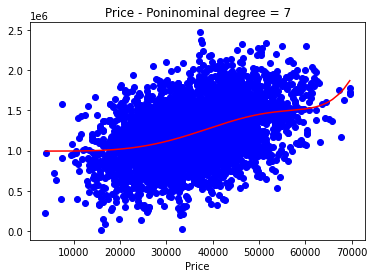

(4000, 9)
Score: 16.134088477709852


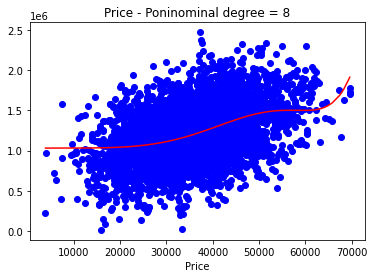

(4000, 10)
Score: 15.520421284032704


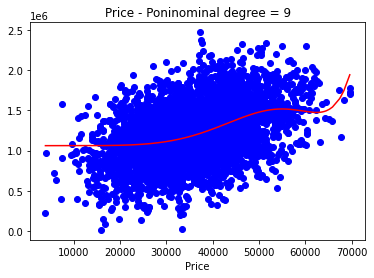

(4000, 11)
Score: 14.7921411362136


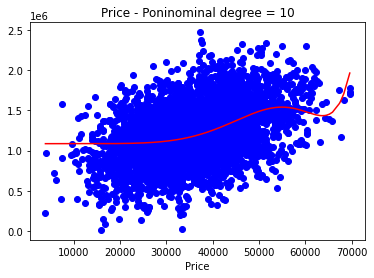

(4000, 3)
Score: 17.148493569365396


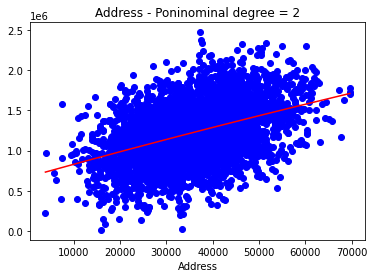

(4000, 4)
Score: 17.152114612255097


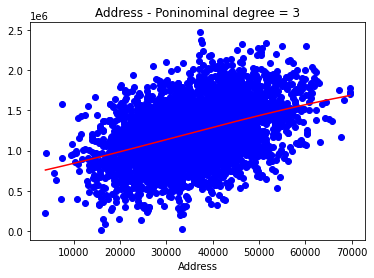

(4000, 5)
Score: 17.141952969807285


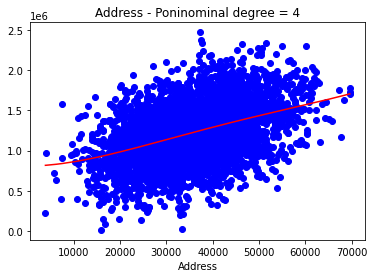

(4000, 6)
Score: 17.081621855388352


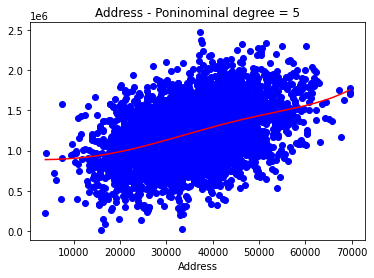

(4000, 7)
Score: 16.91566026496024


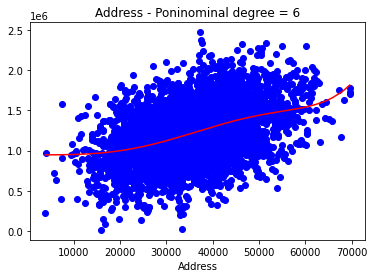

(4000, 8)
Score: 16.60384095702834


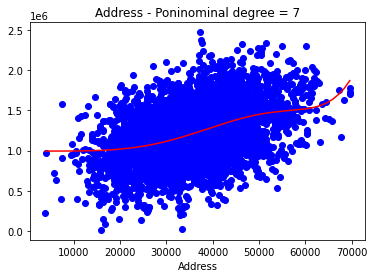

(4000, 9)
Score: 16.134088477709852


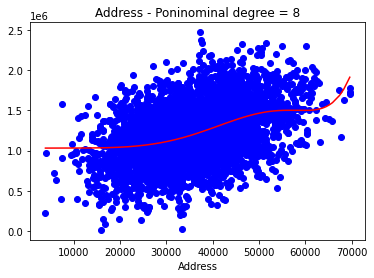

(4000, 10)
Score: 15.520421284032704


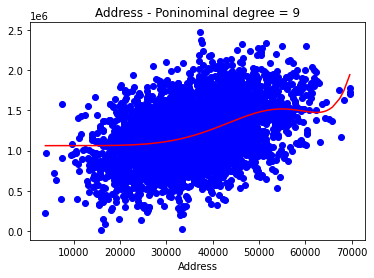

(4000, 11)
Score: 14.7921411362136


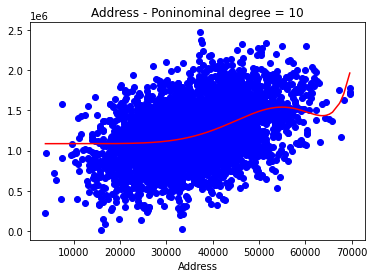

In [4]:
#Resresion Polinómica
for x in df.columns:
    if x != "Price" and x != "Address":
        X_train, X_test, y_train, y_test = train_test_split(df[x].values, df['Price'].values,test_size=0.2)

    degree_min = 2
    degree_max = 10
    
    for degree in range(degree_min,degree_max+1):
        #Paso nº1 -llamamos a fit_transform.   Calculamos las pendientes 
        polinominal_model = PolynomialFeatures(degree) 
        X_poly = polinominal_model.fit_transform(X_train.reshape(-1, 1), y_train)#calculamos las pendientes
        print(X_poly.shape) #PARA YO ENTENDERLO. Esto seria nuestro X_train: X_poly = X_train
        #paso nº2
        lin_reg_model = LinearRegression()
        lin_reg_model.fit(X_poly, y_train)
        y_pred = lin_reg_model.predict(X_poly)
        print("Score:", (r2_score(y_train, y_pred)) * 100) #metrica para q veamos cuanto de bien ha acertado.Recordamos que los score para las regresiones no es tan bueno, pero esto parece que algo si

        X_train_to_show, y_train_to_show = zip(*sorted(zip(X_train, y_train))) #ordeno los valores de X_train con sus respectivos valores de y_train simplemente para poder mostrar
        plt.scatter(X_train_to_show, y_train_to_show, color='b') #Valores que ha entrenado en azul
        X_train_to_show, y_pred = zip(*sorted(zip(X_train, y_pred)))
        plt.plot(X_train_to_show, y_pred, color='red') #Valores predecidos en linea roja
        plt.title(x + " - Poninominal degree = " + str(degree))
        plt.xlabel(x)
        plt.show()

Con regregsion polinómica: Para algunas columnas (X) si se estanca a partir de cierto grado pero hay otras columnas que sigue aumentando hasta llegar al grado 10

#### SVR:

In [5]:
from sklearn.svm import SVR

In [72]:
yS.shape

(5000,)

Score: 0.08576299080311767


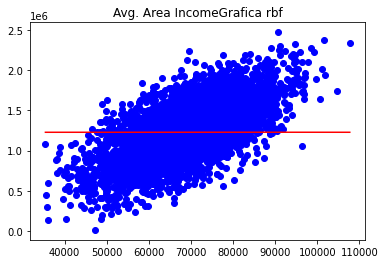

Score: 35.589289357466


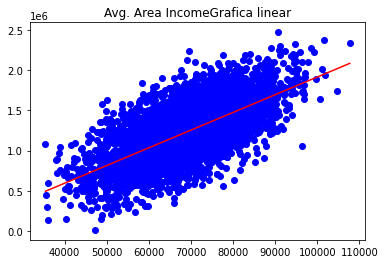

Score: 34.51770765225406


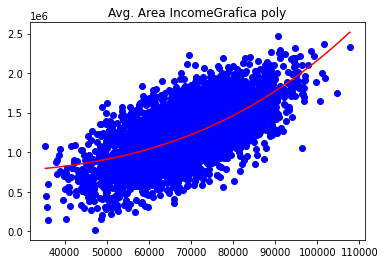

Score: 0.11067524480473656


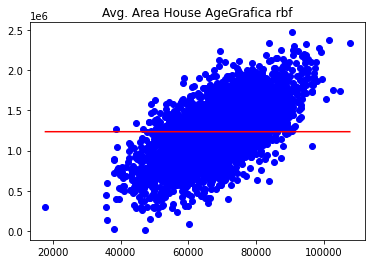

Score: 40.78211773195869


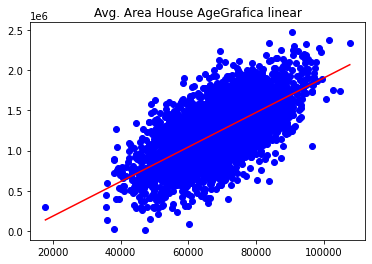

Score: 39.521848223243495


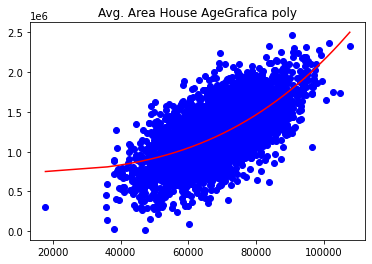

Score: 0.14251219173173624


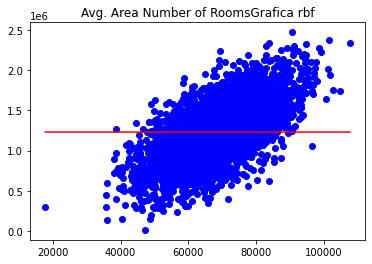

Score: 38.519621840693574


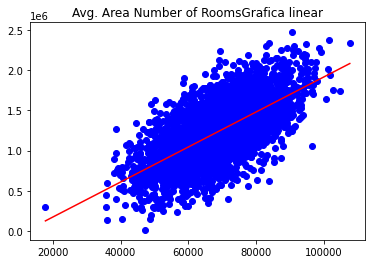

Score: 37.57599351227305


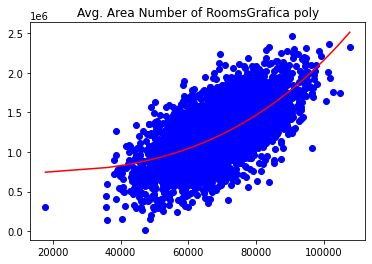

Score: 0.11911173767089611


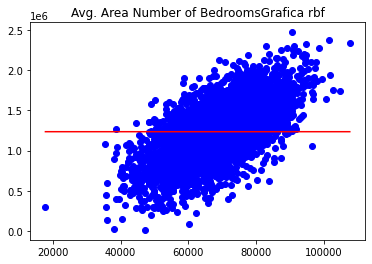

Score: 39.76891352993065


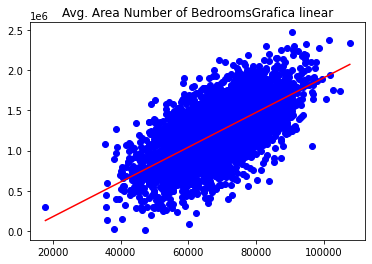

Score: 39.177578662864654


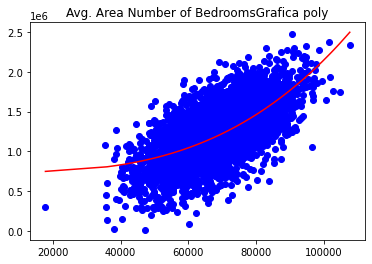

Score: 0.02194372736989969


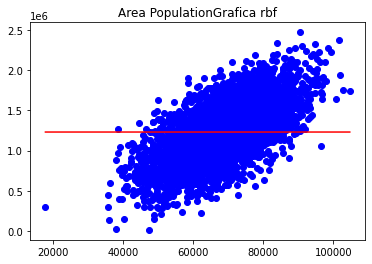

Score: 40.87789955980408


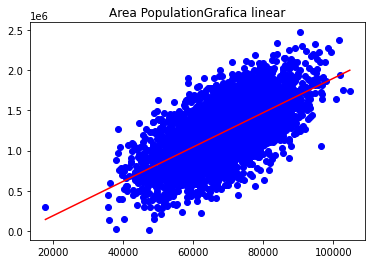

Score: 40.29208783568493


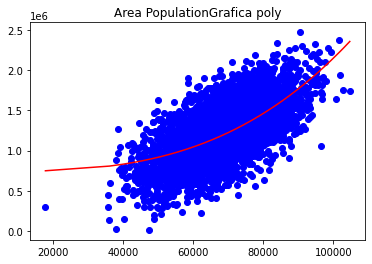

In [21]:
#SVR

for x in df.columns:
    if x != "Price" and x != "Address":
        

        kernel_label = ['rbf', 'linear', 'poly']
        XS = df["Avg. Area Income"]
        yS= df["Price"]
        XS = np.array(XS).reshape(-1,1)
        yS = np.array(yS)
        XS_train, XS_test, yS_train, yS_test = train_test_split(XS,yS,test_size = 0.2)
        for k in kernel_label:
            model_svr_rbf = SVR(kernel=k)
            model_svr_rbf.fit(XS_train, yS_train)
            yS_pred = model_svr_rbf.predict(XS_train)
            print("Score:", (model_svr_rbf.score(XS_test, yS_test)) * 100)

            XS_train_to_show, yS_train_to_show = zip(*sorted(zip(XS_train, yS_train))) 
            plt.scatter(XS_train_to_show, yS_train_to_show, color='b') #Valores que ha entrenado en azul
            XS_train_to_show, yS_pred = zip(*sorted(zip(XS_train, yS_pred)))
            plt.plot(XS_train_to_show, yS_pred, color='red') #Valores predecidos en linea roja
            plt.title(x + "Grafica" + str(k)) 
            plt.show()


### 2. Se pide:

En el anterior dataset, la columna "Avg. Area Number of Bedrooms" está en un rango numérico limitado:

1. Cambia todos los datos para que sean enteros redondeando hacia el entero más cercano. Si es .5 exacto, se redondea hacia abajo.

2. Cuando lo hayas hecho, tendrás una columna con números enteros en un rango limitado. Ahora trata a esa columna como una serie de valores discretos (classes, labels). 

3. Usando las demás columnas numéricas y una a una, utiliza SVM (SVC) para clasificar esa columna modificada.

4. Usando todas las demás columnas a la vez, utiliza SVM para clasificar esa columna modificada. Es decir, "Avg. Area Income" con nuestro target, después "Avg. Area House Age", ... ¿hace aumentar el score? ¿por qué? 

5. ¿Qué columna tiene mejor correlación con "Avg. Area Number of Bedrooms" una vez modificada? ¿qué columna da mejor score para nuestro target? 

ACLARACIÓN del apartado 2 del ejercicio 2:

- El punto 3, se espera que tu X sea una sola columna e y también, 'Avg. Area Number of Bedrooms'.

- El punto 4, espera que tu X sean todas las columnas que cumplen con las características especificadas e y la columna 'Avg. Area Number of Bedrooms'

In [7]:
dfcopia = df.copy()

In [8]:
dfcopia["Avg. Area Number of Bedrooms"] = dfcopia["Avg. Area Number of Bedrooms"].astype(int)

In [9]:
dfcopia.head()

In [58]:
#SVC
# las columnas X las cogemos por separado  y = dfcopia["Avg. Area Number of Bedrooms"]:

print("Target = Avg. Area Number of Bedrooms")
for i in dfcopia.columns:
    if (i != "Avg. Area Number of Bedrooms") and (i != "Address"):
        Xsvc = dfcopia[i]
        ysvc= dfcopia["Avg. Area Number of Bedrooms"]
        Xsvc = np.array(Xsvc).reshape(-1,1)
        ysvc = np.array(ysvc)
        Xsvc_train, Xsvc_test, Ysvc_train, Ysvc_test = train_test_split(Xsvc,ysvc,test_size=0.20)
        C = 100
        gamma = 10
        clf = svm.SVC(C=C, kernel='rbf', gamma=gamma) #Ya utilizamos un modelo de SVC (no la linear) sino con un kernel rbf
        clf.fit(Xsvc_train, Ysvc_train)
        score = clf.score(Xsvc_test, Ysvc_test) * 100
        print ('X = ', i ," score = ",score)

Target = Avg. Area Number of Bedrooms
X =  Avg. Area Income  score =  31.6
X =  Avg. Area House Age  score =  32.300000000000004
X =  Avg. Area Number of Rooms  score =  29.9
X =  Area Population  score =  28.799999999999997
X =  Price  score =  30.4


In [62]:
#SVC
#X seran todas las columnas e y = dfcopia["Avg. Area Number of Bedrooms"
X3 = np.array(dfcopia.drop(['Avg. Area Number of Bedrooms', "Address"], axis=1))
y3 = np.array(dfcopia['Avg. Area Number of Bedrooms'])
X3_train, X3_test, Y3_train, Y3_test = train_test_split(X3,y3,test_size=0.20)
C = 100
gamma = 10
clf = svm.SVC(C=C, kernel='rbf', gamma=gamma) #Ya utilizamos un modelo de SVC (no la linear) sino con un kernel rbf
clf.fit(X3_train, Y3_train)
score = clf.score(X3_test, Y3_test) * 100
print("X = todas las columnas")
print("y = Target. Avg.Number of Bedrooms")
print ("score = ",score)

X = todas las columnas
y = Target. Avg.Number of Bedrooms
score =  29.299999999999997


Correlación de las columnas con "Avg. Area Number of Bedrooms":

(array([0.5, 1.5, 2.5, 3.5, 4.5, 5.5]),
 [Text(0.5, 0, 'Avg. Area Income'),
  Text(1.5, 0, 'Avg. Area House Age'),
  Text(2.5, 0, 'Avg. Area Number of Rooms'),
  Text(3.5, 0, 'Avg. Area Number of Bedrooms'),
  Text(4.5, 0, 'Area Population'),
  Text(5.5, 0, 'Price')])

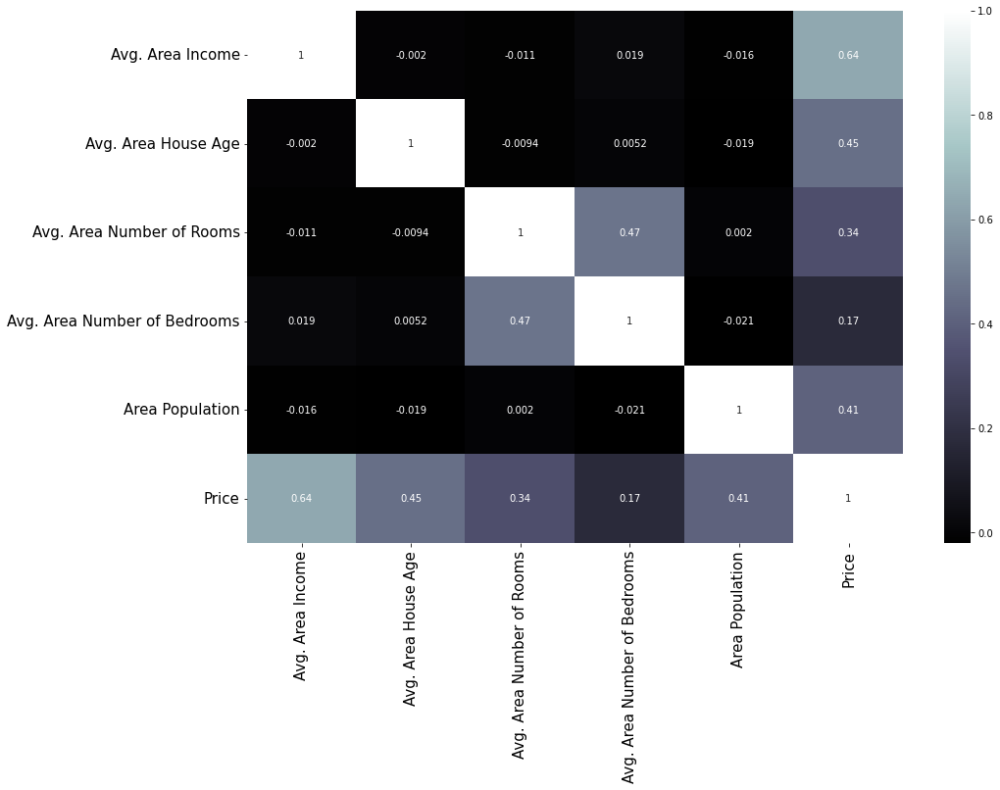

In [36]:
# Creating the graph
plt.figure(figsize=(15,10))
correlation_covid = dfcopia.corr()
heatmap_covid = sns.heatmap(correlation_covid, cmap="bone",annot=True)
fig_corr_covid = heatmap_covid.get_figure()

# Labels
plt.yticks(va="center", rotation = 0, fontsize=15)
plt.xticks(fontsize=15)